In [1]:
# This Python 3 environment comes with many helpful analytics libraries installed
# It is defined by the kaggle/python docker image: https://github.com/kaggle/docker-python
# For example, here's several helpful packages to load in 

import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)

# Input data files are available in the "../input/" directory.
# For example, running this (by clicking run or pressing Shift+Enter) will list all files under the input directory

import os
for dirname, _, filenames in os.walk('/kaggle/input'):
    for filename in filenames:
        print(os.path.join(dirname, filename))

# Any results you write to the current directory are saved as output.

/kaggle/input/jigsaw-multilingual-toxic-comment-classification/jigsaw-unintended-bias-train.csv
/kaggle/input/jigsaw-multilingual-toxic-comment-classification/validation-processed-seqlen128.csv
/kaggle/input/jigsaw-multilingual-toxic-comment-classification/jigsaw-toxic-comment-train-processed-seqlen128.csv
/kaggle/input/jigsaw-multilingual-toxic-comment-classification/validation.csv
/kaggle/input/jigsaw-multilingual-toxic-comment-classification/test-processed-seqlen128.csv
/kaggle/input/jigsaw-multilingual-toxic-comment-classification/jigsaw-toxic-comment-train.csv
/kaggle/input/jigsaw-multilingual-toxic-comment-classification/test.csv
/kaggle/input/jigsaw-multilingual-toxic-comment-classification/sample_submission.csv
/kaggle/input/jigsaw-multilingual-toxic-comment-classification/jigsaw-unintended-bias-train-processed-seqlen128.csv
/kaggle/input/images/nuclear.png
/kaggle/input/images/boxing.png
/kaggle/input/images/safe-zone.png
/kaggle/input/images/grenade.png
/kaggle/input/images/s

In [2]:
#importing important packages

from nltk.sentiment.vader import SentimentIntensityAnalyzer

/opt/conda/lib/python3.6/site-packages/nltk/twitter/__init__.py:20: UserWarning: The twython library has not been installed. Some functionality from the twitter package will not be available.
  warnings.warn("The twython library has not been installed. "


In [3]:
DATA_PATH = "/kaggle/input/jigsaw-multilingual-toxic-comment-classification/"
os.listdir(DATA_PATH)

['jigsaw-unintended-bias-train.csv',
 'validation-processed-seqlen128.csv',
 'jigsaw-toxic-comment-train-processed-seqlen128.csv',
 'validation.csv',
 'test-processed-seqlen128.csv',
 'jigsaw-toxic-comment-train.csv',
 'test.csv',
 'sample_submission.csv',
 'jigsaw-unintended-bias-train-processed-seqlen128.csv']

In [4]:
TEST_PATH = DATA_PATH + 'test.csv'
VAL_PATH  = DATA_PATH + 'validation.csv'
TRAIN_PATH = DATA_PATH + 'jigsaw-toxic-comment-train.csv'

val_data = pd.read_csv(VAL_PATH)
test_data = pd.read_csv(TEST_PATH)
train_data = pd.read_csv(TRAIN_PATH)


In [5]:
train_data.tail()

,id,comment_text,toxic,severe_toxic,obscene,threat,insult,identity_hate
223544,fff8f64043129fa2,":Jerome, I see you never got around to this…! ...",0,0,0,0,0,0
223545,fff9d70fe0722906,==Lucky bastard== \n http://wikimediafoundatio...,0,0,0,0,0,0
223546,fffa8a11c4378854,==shame on you all!!!== \n\n You want to speak...,0,0,0,0,0,0
223547,fffac2a094c8e0e2,MEL GIBSON IS A NAZI BITCH WHO MAKES SHITTY MO...,1,0,1,0,1,0
223548,fffb5451268fb5ba,""" \n\n == Unicorn lair discovery == \n\n Suppo...",0,0,0,0,0,0


In [6]:
test_data.head()

,id,content,lang
0,0,Doctor Who adlı viki başlığına 12. doctor olar...,tr
1,1,"Вполне возможно, но я пока не вижу необходимо...",ru
2,2,"Quindi tu sei uno di quelli conservativi , ...",it
3,3,Malesef gerçekleştirilmedi ancak şöyle bir şey...,tr
4,4,:Resim:Seldabagcan.jpg resminde kaynak sorunu ...,tr


In [7]:
val_data.head()

,id,comment_text,lang,toxic
0,0,Este usuario ni siquiera llega al rango de ...,es,0
1,1,Il testo di questa voce pare esser scopiazzato...,it,0
2,2,Vale. Sólo expongo mi pasado. Todo tiempo pasa...,es,1
3,3,Bu maddenin alt başlığı olarak uluslararası i...,tr,0
4,4,Belçika nın şehirlerinin yanında ilçe ve belde...,tr,0


**LET'S LOOK AT THE DIVISION**

In [8]:
print('TRAIN::',train_data.shape[0],'TEST::',test_data.shape[0])

TRAIN:: 223549 TEST:: 63812


**FINDING THE MOST COMMON WORDS**

In [9]:
from wordcloud import WordCloud
import plotly.express as px
import matplotlib.pyplot as plt

def remove_nan(word):
    if type(word)==str:
        return word.replace("\n", "")
    else:
        return ""

#replacing nan with ''
text = ' '.join([remove_nan(x) for x in train_data['comment_text']])

wordcloud = WordCloud(max_font_size = None,background_color = 'red',collocations=False,width =1500,height = 1200).generate(text)
fig = px.imshow(wordcloud)
fig.update_layout(title_text = ' Most Common words in comments')

**MOST COMMON WORDS WE SEE HERE ARE-** article, page,talk, will,one , will, edit* ,*obscence words are less often

**Dealing With Null values**

In [10]:
print('Train Data Null values:')
check_null = train_data.isnull().sum()
print(check_null)
print('Test Data Null values:')
check_null = test_data.isnull().sum()
print(check_null)


Train Data Null values:
id               0
comment_text     0
toxic            0
severe_toxic     0
obscene          0
threat           0
insult           0
identity_hate    0
dtype: int64
Test Data Null values:
id         0
content    0
lang       0
dtype: int64


**There are no null values the data is clean so far :)**

**Crrating a bar plot for different negative comments category**

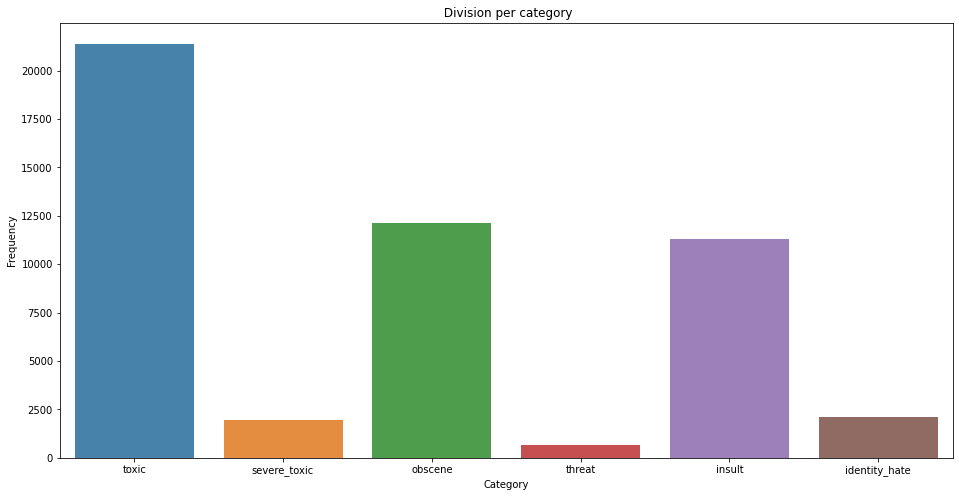

In [11]:

import seaborn as sns
target_columns = train_data.iloc[:,2:].sum()
plt.figure(figsize=(16,8))
ax = sns.barplot(target_columns.index, target_columns.values,alpha=0.9 )
plt.title(" Division per category")
plt.xlabel("Category")
plt.ylabel("Frequency")


plt.show()

In [12]:
#Checking  the class imbalance
x=train_data.iloc[:,2:].sum()
rowsums = train_data.iloc[:,2:].sum(axis=1)
train_data['clean']= (rowsums==0)
#Checking how many comments are totally clean without any negative tags
train_data['clean'].sum()
print('Total comments are  =  ',len(train_data))
print('Total clean comments = ',train_data['clean'].sum())
print('Total number of tags',x.sum())


Total comments are  =   223549
Total clean comments =  201081
Total number of tags 49596


**Checking for multiple tags**

In [13]:
x_data=train_data.iloc[:,2:].sum(axis=1).value_counts()
#plot
import plotly.express as px
fig = px.bar(x_data, x=x_data.index, y=x_data.values)
fig.update_layout(title_text="Multiple tags", template="plotly_white")
fig.show()

**LET'S GENERATE SOME MORE NASTY COMMENTS** FOR FUN !!

In [14]:

import markovify as mk
doc = train_data.loc[train_data.clean==0,'comment_text'].tolist()
text_model = mk.Text(doc)
for i in range(5):
    print(text_model.make_sentence())

I am talking about your own country you british fucker.
I am going to continue using them.
This user has made the comments?
Proud to be positive
First of all, the book is the place.


**LET'S GENERATE SOME CLEAN COMMENTS WITH NO OR ZERO NEGATIVITY** 

In [15]:

import markovify as mk
doc = train_data.loc[train_data.clean==1,'comment_text'].tolist()
text_model = mk.Text(doc)
for i in range(5):
    print(text_model.make_sentence())

Don't you mind explaining the relationship is notable.
LAW IS AT YOUR REVIEW PAGE>YOU WILL GET A LIFE 97.102.60.171
To be frank but your username and all the major rewrite that would help me.
This line is a chapter of this king's reign.
Have you got that warning you will be if he hadn't made those edits.


**Now let's create word clouds of different target tag categories i.e Obscene, Toxic, Identity Threat etc**

In [ ]:
from PIL import Image
from nltk.corpus import stopwords
stop_words=set(stopwords.words())
clean_mask = np.array(Image.open("../input/images/safe-zone.png"))
clean_mask = clean_mask[:,:,1]
#wordcloud for clean comments
subset = train_data[train_data.clean==1]
text = subset.comment_text.values
wc = WordCloud(background_color='black',max_words=2000,mask=clean_mask,stopwords=stop_words)
wc.generate(" ".join(text))
plt.figure(figsize=(20,10))
plt.axis('off')
plt.title('Words frequent in clean comments',fontsize=20)
plt.imshow(wc.recolor(colormap = 'viridis',random_state=17), alpha=0.98)
plt.show()


In [ ]:
from PIL import Image
from nltk.corpus import stopwords
stop_words=set(stopwords.words())
clean_mask = np.array(Image.open("../input/images/nuclear.png"))
clean_mask = clean_mask[:,:,1]
#wordcloud for clean comments
subset = train_data[train_data.toxic==1]
text = subset.comment_text.values
wc = WordCloud(background_color='black',max_words=2000,mask=clean_mask,stopwords=stop_words)
wc.generate(" ".join(text))
plt.figure(figsize=(20,10))
plt.axis('off')
plt.title(' Frequency of words in Toxic comments',fontsize=20)
plt.imshow(wc.recolor(colormap = 'viridis',random_state=17), alpha=0.98)
plt.show()


In [ ]:
from PIL import Image
from nltk.corpus import stopwords
stop_words=set(stopwords.words())
clean_mask = np.array(Image.open("../input/images/nuclear.png"))
clean_mask = clean_mask[:,:,1]
#wordcloud for clean comments
subset = train_data[train_data.severe_toxic==1]
text = subset.comment_text.values
wc = WordCloud(background_color='white',max_words=2000,mask=clean_mask,stopwords=stop_words)
wc.generate(" ".join(text))
plt.figure(figsize=(20,10))
plt.axis('off')
plt.title('Words frequent in Severe comments',fontsize=20)
plt.imshow(wc.recolor(colormap = 'viridis',random_state=17), alpha=0.98)
plt.show()


In [ ]:
from PIL import Image
from nltk.corpus import stopwords
stop_words=set(stopwords.words())
clean_mask = np.array(Image.open("../input/images/nuclear.png"))
clean_mask = clean_mask[:,:,1]
#wordcloud for clean comments
subset = train_data[train_data.obscene==1]
text = subset.comment_text.values
wc = WordCloud(background_color='red',max_words=2000,mask=clean_mask,stopwords=stop_words)
wc.generate(" ".join(text))
plt.figure(figsize=(20,10))
plt.axis('off')
plt.title('Words frequent in obscene comments',fontsize=20)
plt.imshow(wc.recolor(colormap = 'viridis',random_state=17), alpha=1)
plt.show()


In [ ]:
from PIL import Image
from nltk.corpus import stopwords
stop_words=set(stopwords.words())
clean_mask = np.array(Image.open("../input/images/nuclear.png"))
clean_mask = clean_mask[:,:,1]
#wordcloud for clean comments
subset = train_data[train_data.insult==1]
text = subset.comment_text.values
wc = WordCloud(background_color='black',max_words=2000,mask=clean_mask,stopwords=stop_words)
wc.generate(" ".join(text))
plt.figure(figsize=(20,10))
plt.axis('off')
plt.title('Words frequent in insult comments',fontsize=20)
plt.imshow(wc.recolor(colormap = 'viridis',random_state=17), alpha=1)
plt.show()


In [ ]:
from PIL import Image
from nltk.corpus import stopwords
stop_words=set(stopwords.words())
clean_mask = np.array(Image.open("../input/images/nuclear.png"))
clean_mask = clean_mask[:,:,1]
#wordcloud for clean comments
subset = train_data[train_data.threat==1]
text = subset.comment_text.values
wc = WordCloud(background_color='pink',max_words=2000,mask=clean_mask,stopwords=stop_words)
wc.generate(" ".join(text))
plt.figure(figsize=(20,10))
plt.axis('off')
plt.title('Words frequent in threat comments',fontsize=20)
plt.imshow(wc.recolor(colormap = 'viridis',random_state=17), alpha=1)
plt.show()


In [ ]:
from PIL import Image
from nltk.corpus import stopwords
stop_words=set(stopwords.words())
clean_mask = np.array(Image.open("../input/images/nuclear.png"))
clean_mask = clean_mask[:,:,1]
#wordcloud for clean comments
subset = train_data[train_data.insult==1]
text = subset.comment_text.values
wc = WordCloud(background_color='blue',max_words=2000,mask=clean_mask,stopwords=stop_words)
wc.generate(" ".join(text))
plt.figure(figsize=(20,10))
plt.axis('off')
plt.title('Words frequent in insult comments',fontsize=20)
plt.imshow(wc.recolor(colormap = 'viridis',random_state=17), alpha=0.98)
plt.show()


In [ ]:
from PIL import Image
from nltk.corpus import stopwords
stop_words=set(stopwords.words())
clean_mask = np.array(Image.open("../input/images/nuclear.png"))
clean_mask = clean_mask[:,:,1]
#wordcloud for clean comments
subset = train_data[train_data.identity_hate==1]
text = subset.comment_text.values
wc = WordCloud(background_color='black',max_words=2000,mask=clean_mask,stopwords=stop_words)
wc.generate(" ".join(text))
plt.figure(figsize=(20,10))
plt.axis('off')
plt.title('Words frequent in identity hate comments',fontsize=20)
plt.imshow(wc.recolor(colormap = 'viridis',random_state=17), alpha=1)
plt.show()


In [ ]:
fig,axes = plt.subplots(ncols=3,figsize=(17,7),dpi=100)
temp = val_data['lang'].value_counts()
sns.barplot(temp.index,temp,ax=axes[0],palette='Set1')

temp = test_data['lang'].value_counts()
sns.barplot(temp.index,temp,ax=axes[1],palette='Set1')
sns.countplot(data=val_data , x='lang' , hue='toxic',ax=axes[2],palette='Set1')
axes[0].set_ylabel('Count')
axes[1].set_ylabel(' ')
axes[2].set_ylabel(' ')
axes[2].set_xlabel(' ')
axes[0].set_title('Language distribution of Validation Dataset',fontsize=13)
axes[1].set_title('Language distribution of Test Dataset', fontsize=13)
axes[2].set_title('Language distribution by Target of Validation Dataset',fontsize=13)
plt.tight_layout()
plt.show()


# Feature Engineering 

**Plot of word density per comment.**

In [ ]:
def word_counter(x):
    if type(x) is str:
        return len(x.split())
    else:
        return 0
    
train_data['comment_word'] = train_data['comment_text'].apply(word_counter)


import matplotlib.pyplot as plt
import seaborn as sns

# matplotlib histogram
plt.hist(train_data['comment_word'], color = 'blue', edgecolor = 'black',
         bins = int(180/5))

# seaborn histogram
sns.distplot(train_data['comment_word'], hist=True, kde=False, 
             bins=int(180/5), color = 'blue',
             hist_kws={'edgecolor':'black'})
# Add labels
plt.title('word density distribution')
plt.xlabel('word count')
plt.ylabel('')

# Sentiment Analysis

**Generally comments with negative sentiments tend to be more toxic**

In [ ]:
from tqdm import tqdm, tqdm_notebook
tqdm_notebook().pandas()
def polarity(x):
    if type(x) == str:
        return SIA.polarity_scores(x)
    else:
        return 1000
    
SIA = SentimentIntensityAnalyzer()
train_data["polarity"] = train_data["comment_text"].progress_apply(polarity)                     

In [ ]:
import plotly.graph_objects as go

fig = go.FigureWidget(go.Histogram(x=[pols["neg"] for pols in train_data["polarity"] if pols["neg"] != 0], marker=dict(
            color='skyblue')
    ))

fig.update_layout(xaxis_title="Negativity level", title_text="Negativity sentiment", template="simple_white")
fig

In [ ]:
train_data['negativity'] = train_data['polarity'].apply(lambda x:
                                                       x['neg'])
df = pd.DataFrame(np.transpose([lang_list, train_data.groupby('lang')
                               .mean()['negativity'].tolist()]))
df.columns = ['Language' , 'Negativity']
df['Negativity'] = df['Negativity'].apply(float)
df = df.query('Negativity !=0')
df['country'] = df['Language'].apply(get_country)
df = df.query("country != 'None'")
fig = px.choropleth(df, locations='country', hover_name='country',
                   projection='natural earth', locationmode='country names',
                   title='Average negative sentiment vs country',color='Negativity',
                   template='plotly',color_continuos_scale='reds')
fig.show()

In [ ]:
val = val_data
train = train_data

def clean(text):
    text = text.fillna('fillna').str.lower()
    text = text.map(lambda x: re.sub('\\n', ' ',str(x)))
    text = text.map(lambda x: re.sub("\[\[User.*", '', str(x)))
    text = text.map(lambda x: re.sub("\d{1,3}\.\d{1,3}\.\d{1,3}\.\d{1,3}",'',str(x)))
    text = text.map(lambda x: re.sub("\(http://.*?\s\(http://.*\)",'',str(x)))
    text = text.map(lambda x: ''.join(''.join(s)[:2] for _, s in itertools.groupby(x)))
    text = text.map(lambda x: re.sub('[^a-zA-Z0-9-_.]', '', str(x)))
    text = text.map(lambda x: x.translate(str.maketrans({"'s": " is", "'re":" are"})))
    return text
